In [2]:
import pandas as pd
import glob
import numpy as np
import os
import cv2
import subprocess
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

from base64 import b64encode
from IPython.display import HTML, Video, display
from colorama import Fore, Back, Style

在这场比赛中，你的任务是预测玩家对之间的接触时刻，以及当玩家使用比赛录像和跟踪数据与地面进行非脚接触时。每个剧本都有四个相关联的视频。两个视频，显示边线和终端区的观点，是时间同步和彼此对齐。此外，提供了一个All29视图，但不保证时间同步。训练集视频在**train/**目录下，对应标签在**train_labels.csv**目录下，需要预测的视频在**test/**文件夹下。

今年我们还为训练和测试集提供了基线头盔检测和分配箱。**train_baseline_helmet .csv**是去年获奖球员分配模型的输出。 
 
**train_player_tracking.csv**提供在提供的比赛期间场上每个球员的10hz跟踪数据。 
 
**train_video_metadata.csv**包含与每个边线和Endzone视图相关联的时间戳，用于与球员跟踪数据同步。 
 
这是一场代码竞赛。当您提交时，您的模型将在位于坚持测试集中的61个未见的游戏集上重新运行。公开提供的测试视频只是一组模拟比赛(从训练集复制)，不用于评分。 
 
相关的** test_baseline_helets .csv**， **test_player_tracking.csv**和**test_video_metadata.csv**在提交时可供您的模型使用。 
 
一个** sample_submit .csv**将在提交时可用，它将包含有效提交所需的所有行。

**[训练/测试]mp4**播放视频。每部剧有三个视频。两个主要的视角是从边线和边线拍摄的。边线和端区视频对在时间上逐帧匹配，但不同的玩家可能在每个视图中可见。今年提供了一个额外的视图，所有29人应该包括参与比赛的每个球员的视图。所有29个视频不保证与边线和结束区时间同步。 
 
这些视频的帧率均为59.95 HZ。在视频开始5秒的时候出现了抓拍的瞬间。

**竞争目标** 
 
简单地说，我们试图预测足球比赛中每0.1秒发生的所有接触时刻。接触可以通过两种方式发生: 
 
*两名球员之间。 
*在球员和地面之间。**注:当球员用手或脚以外的任何东西触地时，即视为触地 
 
参赛作品应包含对22名球员所有可能组合的预测，以及每个球员在比赛中每个时间步骤的场地。每个预测对只需要一行，较低的玩家的nfl_player_id为nfl_player_id_1，较大的玩家为nfl_player_id_2。

#视频元数据

每个边线和结束区视频文件的元数据，包括用于与球员跟踪数据同步的时间戳信息。 
 
' game_play ':唯一的游戏键和游戏id组合。 
' game_key ':游戏的ID代码。 
* ' play_id ':游戏的ID代码。 
' view ':视频视图，可以是球场边线或球门区
* ' start_time ':视频开始的时间戳。 
* ' end_time ':视频结束时的时间戳。 
* ' snap_time ':视频开始播放时的时间戳。这是视频开始的5秒(300帧)。


In [3]:
train_metadata_df = pd.read_csv('./nfl-player-contact-detection_data/train_video_metadata.csv')
test_metadata_df = pd.read_csv('./nfl-player-contact-detection_data/test_video_metadata.csv')

FileNotFoundError: [Errno 2] No such file or directory: './nfl-player-contact-detection_data/train_video_metadata.csv'

In [ ]:
train_metadata_df.head(3)

**Train metadata**

In [3]:
train_metadata_df['end_time'] = train_metadata_df.end_time.apply(pd.to_datetime)
train_metadata_df['start_time'] = train_metadata_df.start_time.apply(pd.to_datetime)

train_metadata_df['duration'] = (train_metadata_df['end_time'] - train_metadata_df['start_time']).dt.total_seconds()

print(f"Shape => {train_metadata_df.shape}")
train_metadata_df.head(3)

Shape => (480, 8)


,game_play,game_key,play_id,view,start_time,end_time,snap_time,duration
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11T03:01:48.134Z,11.837
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11T03:01:48.134Z,11.837
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13T19:30:47.414Z,18.110


In [4]:
train_metadata_df.game_play.nunique()

240

In [5]:
train_metadata_df.view.value_counts()

Sideline    240
Endzone     240
Name: view, dtype: int64

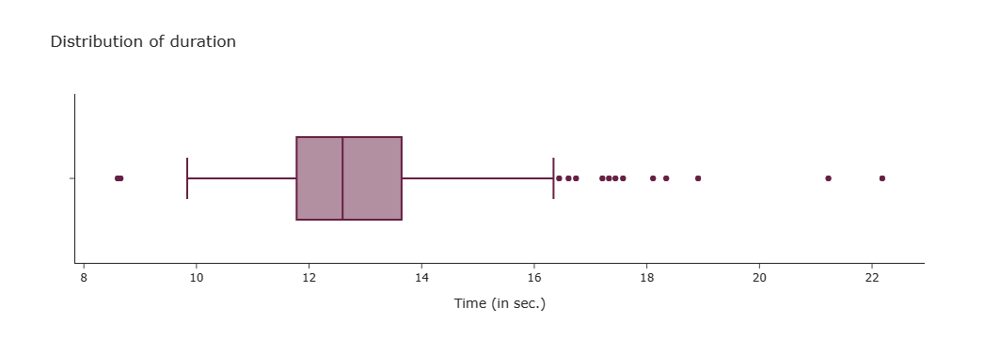

In [6]:
fig = px.box(x=train_metadata_df['duration'],
             template='simple_white',
             title='Distribution of duration',
             labels={'x': 'Time (in sec.)'},
             
             color_discrete_sequence=px.colors.sequential.Burg_r)

fig.update_layout(coloraxis_showscale=False)
fig.show()

每个视频时长为8-20秒，主要在12-13秒左右

**Test metadata**

In [7]:
test_metadata_df['end_time'] = test_metadata_df.end_time.apply(pd.to_datetime)
test_metadata_df['start_time'] = test_metadata_df.start_time.apply(pd.to_datetime)

test_metadata_df['duration'] = (test_metadata_df['end_time'] - test_metadata_df['start_time']).dt.total_seconds()

print(f"Shape => {test_metadata_df.shape}")
test_metadata_df.head()

Shape => (4, 8)


,game_play,game_key,play_id,view,start_time,end_time,snap_time,duration
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11T03:01:48.134Z,11.837
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11T03:01:48.134Z,11.837
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13T19:30:47.414Z,18.110
3,58172_003247,58172,3247,Sideline,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13T19:30:47.414Z,18.110


#视频标签

包含一行的球员组合，和球员与地面为每个0.1秒的时间戳在发挥。

*“contact_id”:game_play, player_ids和step列的组合。
' game_play ':游戏和游戏的唯一ID。
* ' nfl_player_id_1 ':联系人对中编号较低的玩家id。如果与地面接触，那么这只是玩家id。
* ' nfl_player_id_2 ':接触对中较大的数字玩家id。如果是为了与地面接触，这将包含大写的“G”
*“step”:表示每次播放的每个时间步长的数字，在播放开始时从0开始，每0.1秒增加1。
* ' datetime ':联系人的时间放大器，10Hz
“contact”:是否发生联系

标签可能不精确，但期望在实际接触时刻的+/-10Hz范围内。标签是在包括质量检查在内的多个步骤中创建的，但是仍然可能有错误的标签。您应该期望测试标签的质量与训练集标签的质量相似。

In [9]:
train_labels_df = pd.read_csv('./nfl-player-contact-detection_data/train_labels.csv')

In [10]:
print(f"Shape => {train_labels_df.shape}")
train_labels_df.head(3)

Shape => (4721618, 7)


,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact
0,58168_003392_0_38590_43854,58168_003392,2020-09-11T03:01:48.100Z,0,38590,43854,0
1,58168_003392_0_38590_41257,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41257,0
2,58168_003392_0_38590_41944,58168_003392,2020-09-11T03:01:48.100Z,0,38590,41944,0


# FPS information for video data

In [11]:
train_fps_dict = {
    'video': [],
    'fps': [],
    'width': [],
    'height': [],
}

for vid_file in glob.glob('./nfl-player-contact-detection_data/train/*'):
    vidcap = cv2.VideoCapture(vid_file)
    vid_name = vid_file.split(os.sep)[-1]

    fps = round(vidcap.get(cv2.CAP_PROP_FPS))
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    train_fps_dict['video'].append(vid_name)
    train_fps_dict['fps'].append(fps)
    train_fps_dict['width'].append(width)
    train_fps_dict['height'].append(height)

In [12]:
train_fps_df = pd.DataFrame(train_fps_dict)
print(train_fps_df.fps.value_counts()); print()
print(train_fps_df.width.value_counts()); print()
print(train_fps_df.height.value_counts())

60    720
Name: fps, dtype: int64

1280    483
1920    237
Name: width, dtype: int64

720     483
1080    237
Name: height, dtype: int64


In [13]:
test_fps_dict = {
    'video': [],
    'fps': [],
    'width': [],
    'height': [],
}

for vid_file in glob.glob('./nfl-player-contact-detection_data/test/*'):
    vidcap = cv2.VideoCapture(vid_file)
    vid_name = vid_file.split(os.sep)[-1]

    fps = round(vidcap.get(cv2.CAP_PROP_FPS))
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    test_fps_dict['video'].append(vid_name)
    test_fps_dict['fps'].append(fps)
    test_fps_dict['width'].append(width)
    test_fps_dict['height'].append(height)

In [14]:
test_fps_df = pd.DataFrame(test_fps_dict)
print(test_fps_df.fps.value_counts()); print()
print(test_fps_df.width.value_counts()); print()
print(test_fps_df.height.value_counts())

60    6
Name: fps, dtype: int64

1280    4
1920    2
Name: width, dtype: int64

720     4
1080    2
Name: height, dtype: int64


为了澄清起见，所有视频都是60帧 
 
此外，我们有两种类型的视频，一种大小(1280x720)和一种大小(1920x1080)


#视频基线头盔

包含不完善的基线预测头盔盒和球员分配边线和结束区视频视图。用于创建这些预测的模型来自去年比赛的获胜解决方案，我们可以用来利用您的预测。

' game_play ':唯一的游戏键和游戏id组合。
' game_key ':游戏的ID代码。
* ' play_id ':游戏的ID代码。
' view ':视频视图，可以是Sideline或Endzone
' video ':相关视频的文件名。
* ' frame ':视频中的相关帧。
*“nfl_player_id”:不完美的预测玩家id。
* ' player_label ':玩家标签。V/H(主队或客队)和球员球衣号码的组合。

In [15]:
train_baseline_df = pd.read_csv('./nfl-player-contact-detection_data/train_baseline_helmets.csv')
test_baseline_df = pd.read_csv('./nfl-player-contact-detection_data/test_baseline_helmets.csv')

In [16]:
print(f"Shape => {train_baseline_df.shape}")
train_baseline_df.head()

Shape => (3783616, 12)


,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
0,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,39947,H72,946,25,293,34
1,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,37211,H42,151,25,267,33
2,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,38590,H70,810,25,293,35
3,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,44822,H15,681,26,254,33
4,58168_003392,58168,3392,Endzone,58168_003392_Endzone.mp4,290,41944,V92,680,23,303,33


In [17]:
num_frames = train_baseline_df[train_baseline_df.game_play=='58168_003392'].frame.nunique()
num_steps = train_labels_df[train_labels_df.game_play=='58168_003392'].step.nunique()

print('Num frames (from time the game start):', num_frames)
print('Num steps (from time the game start):', num_steps)

Num frames (from time the game start): 420
Num steps (from time the game start): 70


我们可以看到，根据baseline.csv文件，labels.csv文件中的每一步都有6帧

每步时长为0.1秒包含6帧(因为所有视频都有60fps)

In [19]:
# 检查是否有缺失值
train_baseline_df.isna().sum()

game_play        0
game_key         0
play_id          0
view             0
video            0
frame            0
nfl_player_id    0
player_label     0
left             0
width            0
top              0
height           0
dtype: int64

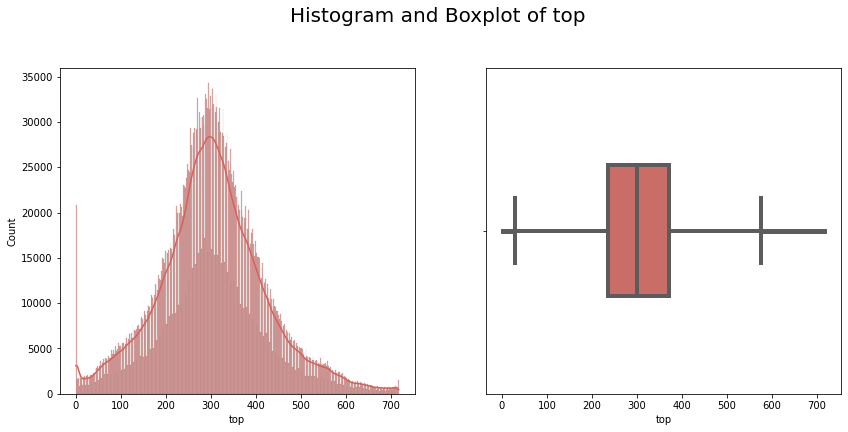

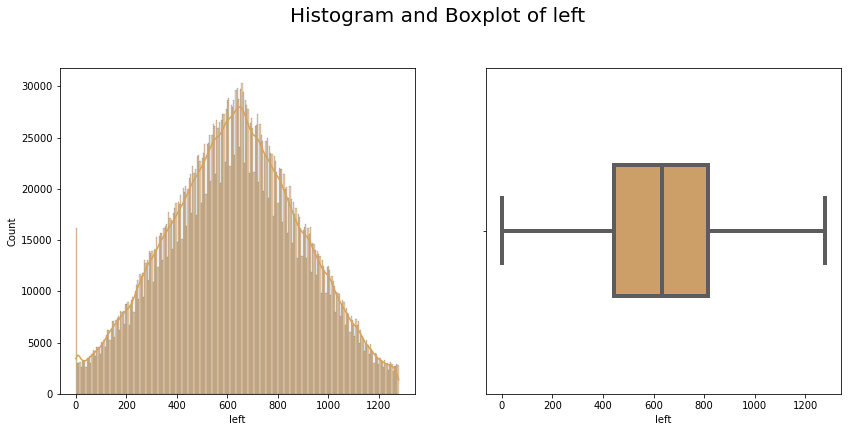

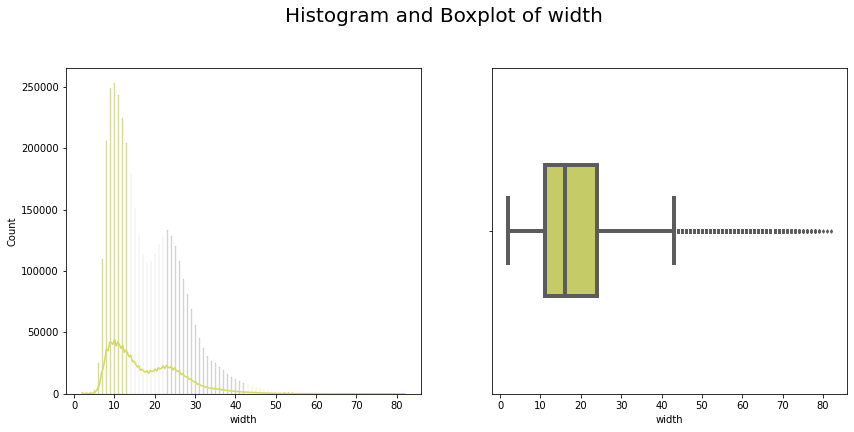

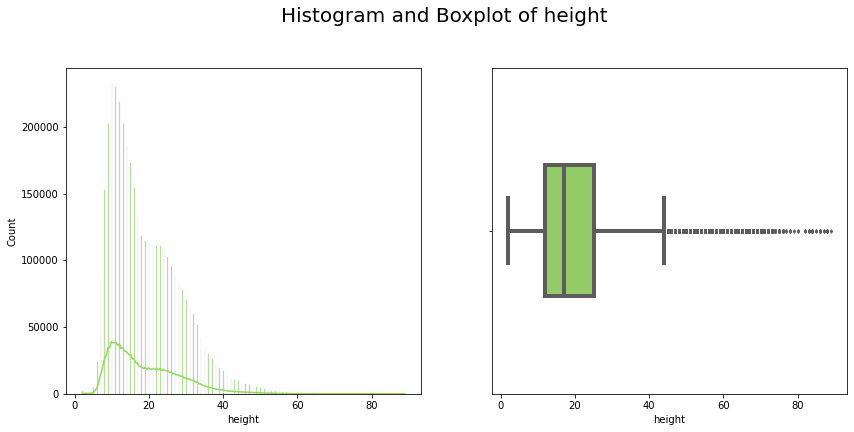

In [20]:
# 直方图和箱线图的左边，宽度，顶部，高度
cols = ['top', 'left', 'width', 'height']

for idx, col in enumerate(cols):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

    sns.histplot(train_baseline_df, x=train_baseline_df[col], kde=True, hue=None,
                 color=sns.color_palette('hls', train_baseline_df.shape[1])[idx], ax=ax1)
    
    sns.boxplot(x=train_baseline_df[col], width=.4, linewidth=4, fliersize=2.5,
                color=sns.color_palette('hls', train_baseline_df.shape[1])[idx], ax=ax2)
    
    fig.suptitle(f'Histogram and Boxplot of {col}', size=20, y=1.02)
    plt.show()

In [21]:
train_baseline_df[train_baseline_df.view == 'Endzone2']

,game_play,game_key,play_id,view,video,frame,nfl_player_id,player_label,left,width,top,height
915722,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,304,43333,V53,142,29,268,37
915723,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,304,44999,V36,1063,26,84,34
915724,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,304,41295,H76,882,31,308,27
915725,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,304,52436,V48,418,27,180,38
915726,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,304,47868,V45,1117,26,271,38
...,...,...,...,...,...,...,...,...,...,...,...,...
935003,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,752,47868,V45,266,33,549,31
935004,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,752,46259,V32,505,28,139,30
935005,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,752,43484,H71,73,30,620,31
935006,58226_003009,58226,3009,Endzone2,58226_003009_Endzone2.mp4,752,41349,H82,820,28,200,36


所有视图“Endzone2”属于“58226_003009” 
 
可能和正常的“Endzone”没有太大区别

#可视化视频注释bbox

**注:一名玩家可与多名玩家接触(包括地面)**

玩家有4种不同接触方式的盒子 
 
“黑色”:没有联系 
*“红色”:与地面接触(仅限) 
*“绿色”:与球员接触(非地面) 
*“棕色”:与球员和地面接触

In [22]:
def video_with_helmets(video_path, baseline_boxes, labels_df=None, verbose=True):
    """
    Annotates a video with baseline model boxes and labels
    """
    VIDEO_CODEC = "MP4V"
    HELMET_TEXT_COLOR = (0, 0, 0)  # Black
    HELMET_FREE_COLOR = (0, 0, 0)  # when player does not has any contact
    HELMET_CONTACT_COLOR = (0, 255, 0)  # when player has contact with other player
    HELMET_GROUND_COLOR = (0, 0, 255)  # when player has contact with ground
    video_name = os.path.basename(video_path)
    video_basename = video_name.rsplit('_', 1)[0]
    if verbose:
        print(f"Running for {video_name}")
    baseline_boxes = baseline_boxes.copy()

    vidcap = cv2.VideoCapture(video_path)
    fps = vidcap.get(cv2.CAP_PROP_FPS)
    width = int(vidcap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(vidcap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    output_path = "labeled_" + video_name
    tmp_output_path = "tmp_" + output_path
    output_video = cv2.VideoWriter(
        tmp_output_path, cv2.VideoWriter_fourcc(*VIDEO_CODEC), fps, (width, height)
    )

    frame = 0
    count_frame_for_each_step = 0  # Reset after 6 frame
    step = 0
    while True:
        it_worked, img = vidcap.read()
        if not it_worked:
            break

        frame += 1
        img_name = video_name.replace(".mp4", "")
        cv2.putText(img, img_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, HELMET_TEXT_COLOR, thickness=1)

        cv2.putText(img, str(frame), (width - 90, height - 20), cv2.FONT_HERSHEY_SIMPLEX, 1, HELMET_TEXT_COLOR, thickness=1)

        # Add box
        boxes = baseline_boxes.query("video == @video_name and frame == @frame")
        
        if len(boxes): # When the game has started
            # print(step)
            if labels_df is not None:
                labels = labels_df.query("game_play == @video_basename and step == @step")
                for box in boxes.itertuples(index=False):  # When the game has started
                    labels_player = labels[(labels.nfl_player_id_1 == box.nfl_player_id) | (labels.nfl_player_id_2 == box.nfl_player_id)]
                    labels_player = labels_player[labels_player.contact != 0]  # select contact time
                    if len(labels_player) == 0:  # if no contact with current player
                        cv2.rectangle(img, (box.left, box.top), (box.left+box.width, box.top+box.height),
                                    HELMET_FREE_COLOR, thickness=2)
                    else:  # if any contact
                        if labels_player.iloc[-1].nfl_player_id_2 == 'G':  # if contact with ground
                            cv2.rectangle(img, (box.left, box.top), (box.left+box.width, box.top+box.height),
                                        HELMET_GROUND_COLOR, thickness=2)
                            if len(labels_player) > 1:  # if player has more than 1 contact
                                cv2.rectangle(img, (box.left, box.top), (box.left+box.width, box.top+box.height),
                                            HELMET_CONTACT_COLOR, thickness=1)
                        else:  # if contact with other player
                            cv2.rectangle(img, (box.left, box.top), (box.left+box.width, box.top+box.height),
                                        HELMET_CONTACT_COLOR, thickness=2)
                    cv2.putText(img, box.player_label, (box.left + 1, max(0, box.top - 20)), cv2.FONT_HERSHEY_SIMPLEX,
                                0.5, HELMET_TEXT_COLOR, thickness=2,)
                    
                count_frame_for_each_step += 1
                if count_frame_for_each_step == 6:
                    step += 1
                    count_frame_for_each_step = 0  # reset
            else:
                for box in boxes.itertuples(index=False):  # When the game has started
                    cv2.rectangle(img, (box.left, box.top), (box.left+box.width, box.top+box.height),
                                HELMET_FREE_COLOR, thickness=2)
                    cv2.putText(img, box.player_label, (box.left + 1, max(0, box.top - 20)), cv2.FONT_HERSHEY_SIMPLEX,
                                0.5, HELMET_TEXT_COLOR, thickness=2,)
            
        output_video.write(img)
    output_video.release()
    # Not all browsers support the codec, we will re-load the file at tmp_output_path
    # and convert to a codec that is more broadly readable using ffmpeg
    if os.path.exists(output_path):
        os.remove(output_path)
    subprocess.run(
        [
            "ffmpeg",
            "-i",
            tmp_output_path,
            "-crf",
            "18",
            "-preset",
            "veryfast",
            "-hide_banner",
            "-loglevel",
            "error",
            "-vcodec",
            "libx264",
            output_path,
        ]
    )
    os.remove(tmp_output_path)

    return output_path

In [23]:
example_video = "./nfl-player-contact-detection_data/train/58176_002844_Sideline.mp4"
output_video = video_with_helmets(example_video, train_baseline_df, train_labels_df)

frac = 0.65  # scaling factor for display
display(
    Video(data=output_video, embed=True, height=int(720 * frac), width=int(1280 * frac))
)

Running for 58176_002844_Sideline.mp4


In [24]:
example_video = "./nfl-player-contact-detection_data/train/58176_002844_Endzone.mp4"
output_video = video_with_helmets(example_video, train_baseline_df, train_labels_df)

frac = 0.65  # scaling factor for display
display(
    Video(data=output_video, embed=True, height=int(720 * frac), width=int(1280 * frac))
)

Running for 58176_002844_Endzone.mp4


In [25]:
example_video = "./nfl-player-contact-detection_data/train/58168_003392_Sideline.mp4"
output_video = video_with_helmets(example_video, train_baseline_df, train_labels_df)

frac = 0.65  # scaling factor for display
display(
    Video(data=output_video, embed=True, height=int(720 * frac), width=int(1280 * frac))
)

Running for 58168_003392_Sideline.mp4


#视频播放器跟踪

Each player wears a sensor that allows us to locate them on the field; that information is reported in these two files.

* `game_play`: 唯一的游戏键和游戏id组合。
* `game_key`: 游戏的ID_Key
* `play_id`: 游戏身份码.
* `nfl_player_id`: NFL球员id.
* `datetime`: 10hz的时间戳.
* `step`: 相对于游戏开始的时间步长.
* `position`: 球员在足球中的位置.
* `team`: 球队的球员，无论是主场还是客场.
* `jersey_number`: 球员球衣号码
* `x_position`: 球员在场地x轴上的位置.
* `y_position`: 球员在场地y轴上的位置.
* `speed`: 速度(码/秒).
* `distance`: 速度(单位:码/秒)从前一个时间点移动的距离(单位:码/秒).
* `orientation`: 玩家方向(度).
* `direction`: 玩家运动角度(度).
* `event`: 游戏事件如噼啪声、哨声等.
* `acceleration`: 总加速度的大小，单位是码/秒^2.
* `sa`: 符号加速度码/秒^2在玩家移动的方向上.

In [26]:
train_player_df = pd.read_csv('./nfl-player-contact-detection_data/train_player_tracking.csv')
test_player_df = pd.read_csv('./nfl-player-contact-detection_data/test_player_tracking.csv')

**Train**

In [27]:
print(f"Shape => {train_player_df.shape}")
train_player_df.head(3)

Shape => (1353053, 17)


,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
0,58580_001136,58580,1136,44830,2021-10-10T21:08:20.900Z,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64
1,58580_001136,58580,1136,47800,2021-10-10T21:08:20.900Z,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90
2,58580_001136,58580,1136,52444,2021-10-10T21:08:20.900Z,-108,away,FS,29,72.19,31.46,0.61,0.06,11.77,247.69,0.63,-0.33


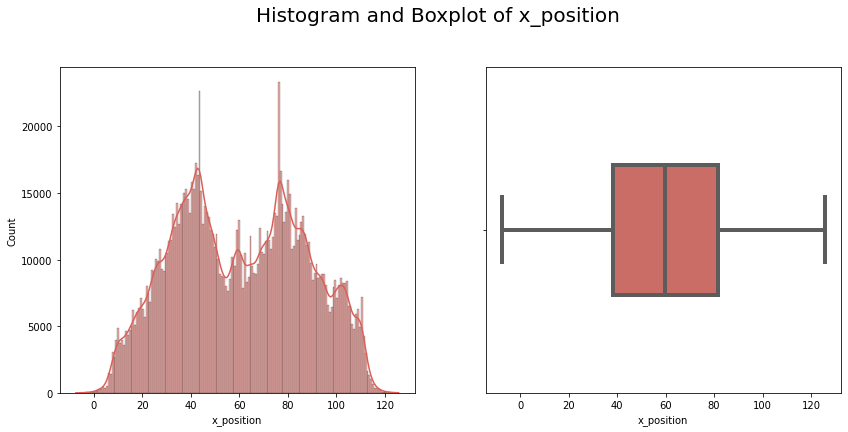

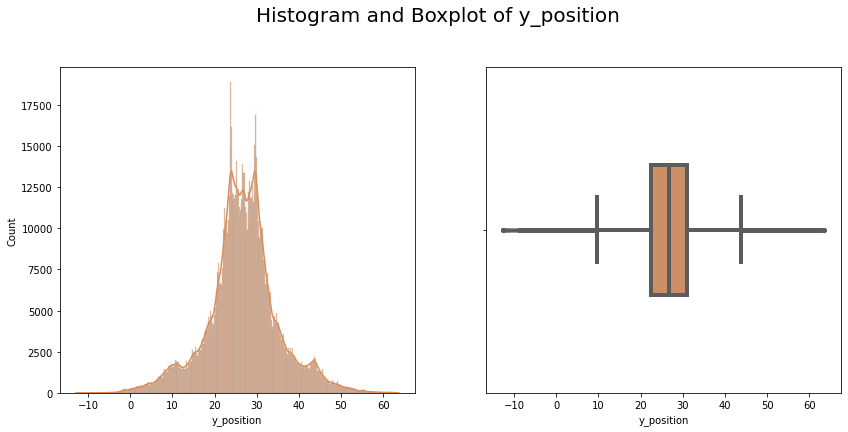

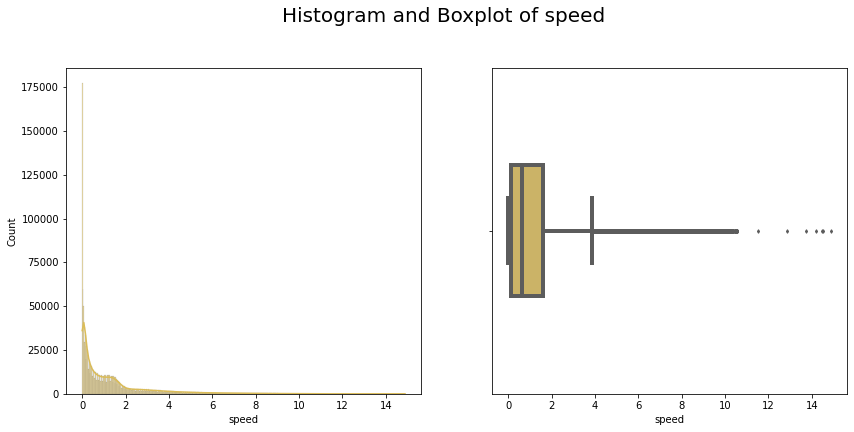

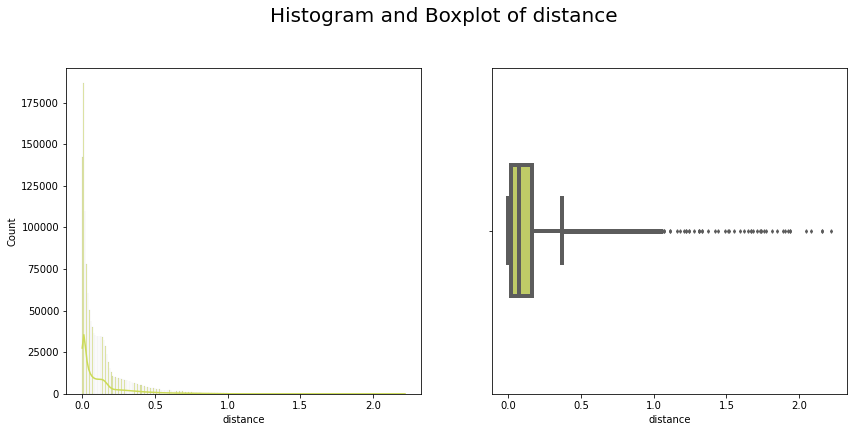

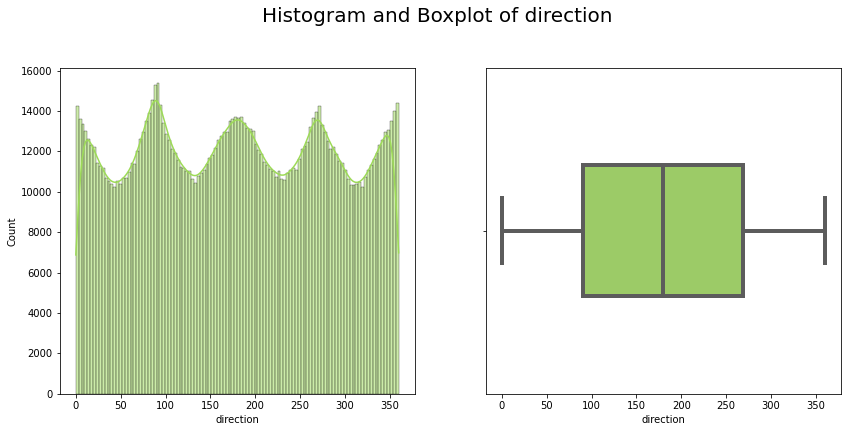

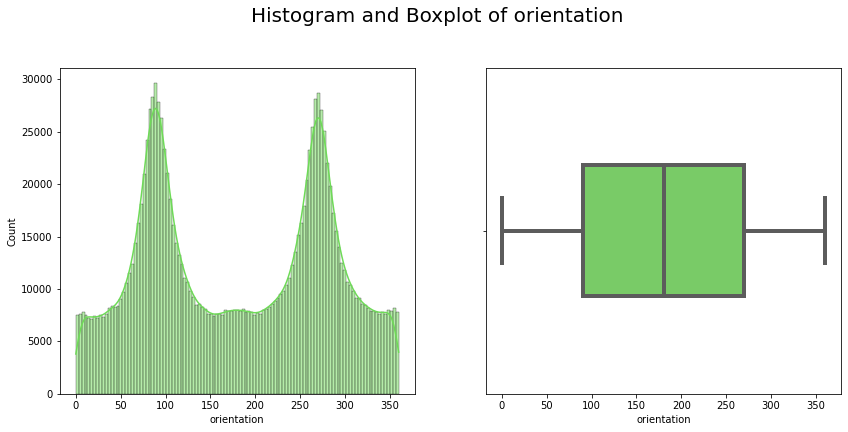

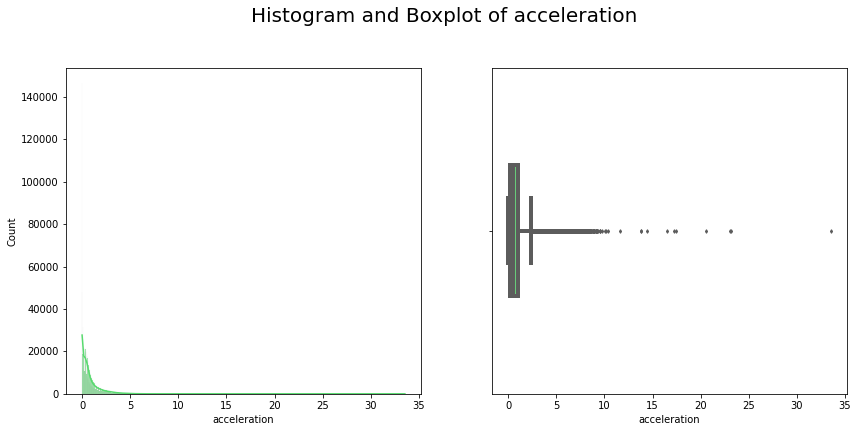

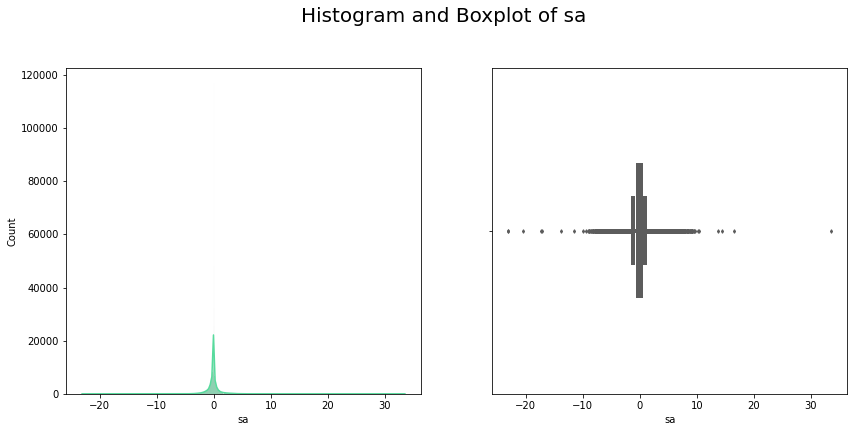

In [28]:
# Histogram and Boxplot
cols = ['x_position', 'y_position', 'speed', 'distance', 'direction', 'orientation', 'acceleration', 'sa']

for idx, col in enumerate(cols):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

    sns.histplot(train_player_df, x=train_player_df[col], kde=True, hue=None,
                 color=sns.color_palette('hls', train_player_df.shape[1])[idx], ax=ax1)
    
    sns.boxplot(x=train_player_df[col], width=.4, linewidth=4, fliersize=2.5,
                color=sns.color_palette('hls', train_player_df.shape[1])[idx], ax=ax2)
    
    fig.suptitle(f'Histogram and Boxplot of {col}', size=20, y=1.02)
    plt.show()

**Test**

In [29]:
print(f"Shape => {test_player_df.shape}")
test_player_df.head(3)

Shape => (14872, 17)


,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
0,58172_003247,58172,3247,41937,2020-09-13T19:30:20.200Z,-272,home,MLB,57,64.28,11.29,4.82,0.46,20.74,12.43,3.13,3.00
1,58172_003247,58172,3247,45345,2020-09-13T19:30:20.200Z,-272,away,ILB,50,76.03,36.74,3.15,0.32,179.52,184.91,1.87,-1.81
2,58172_003247,58172,3247,46205,2020-09-13T19:30:20.200Z,-272,home,DE,98,65.64,15.74,1.80,0.20,6.73,339.85,0.69,-0.68


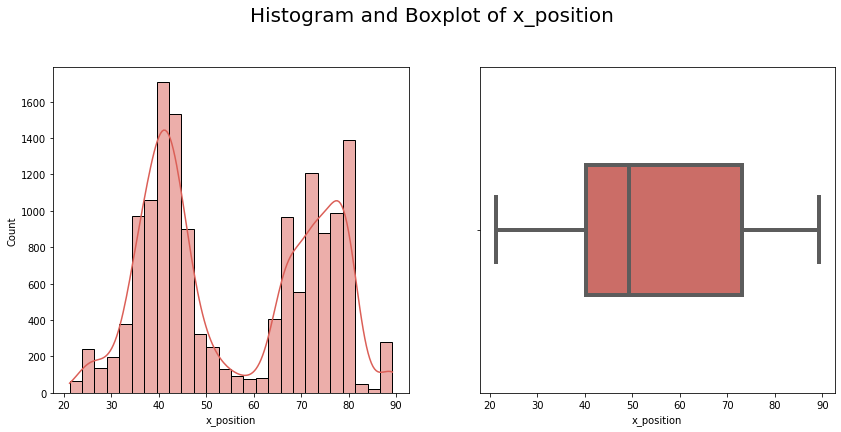

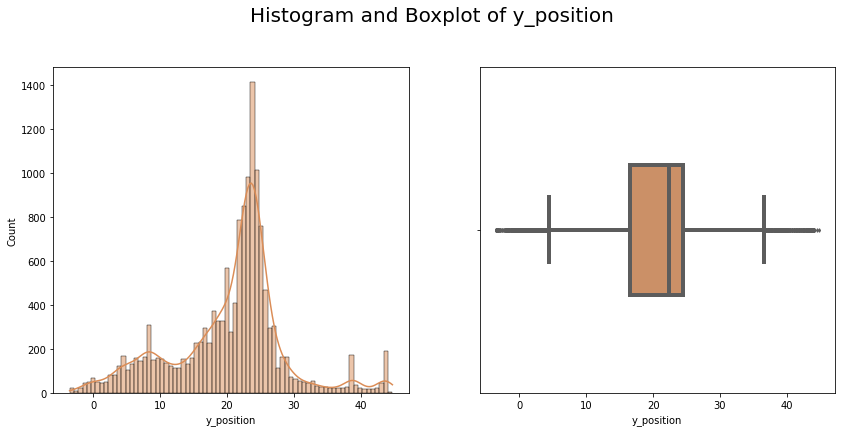

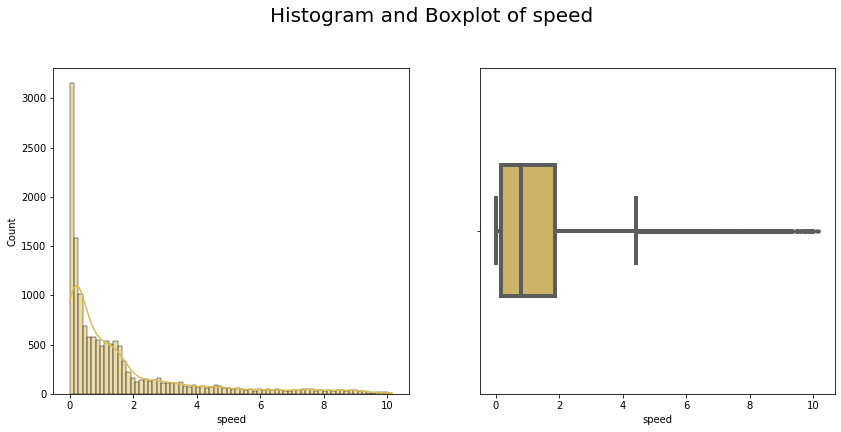

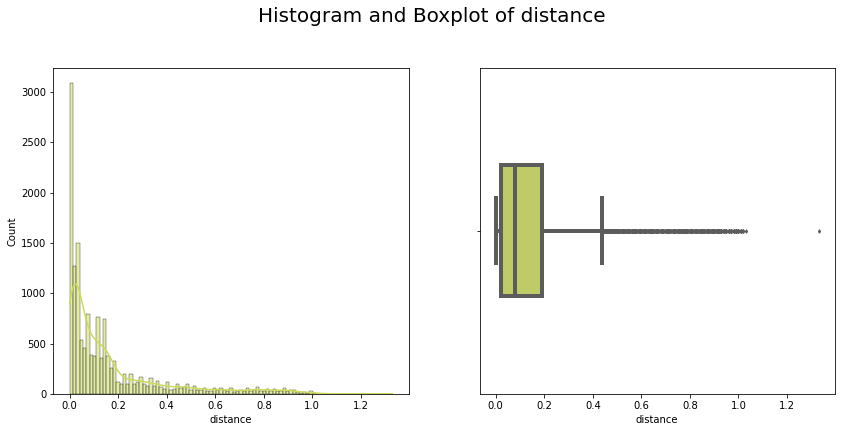

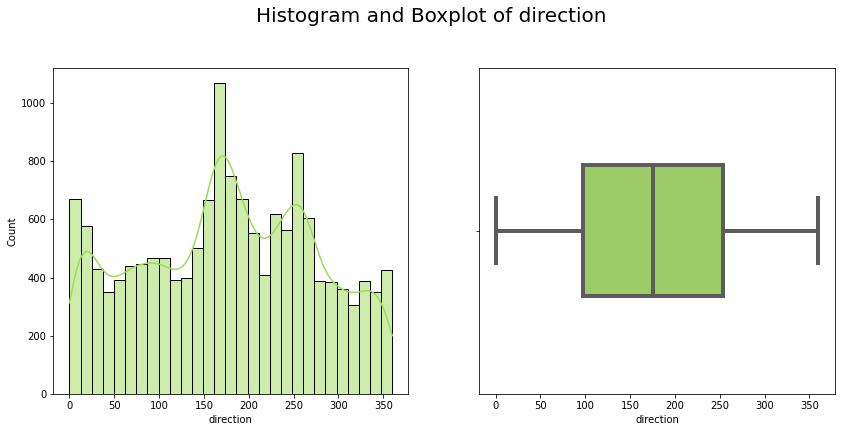

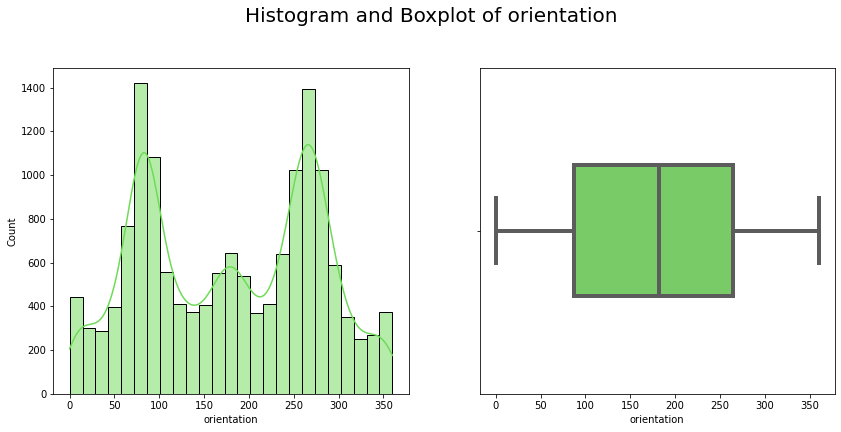

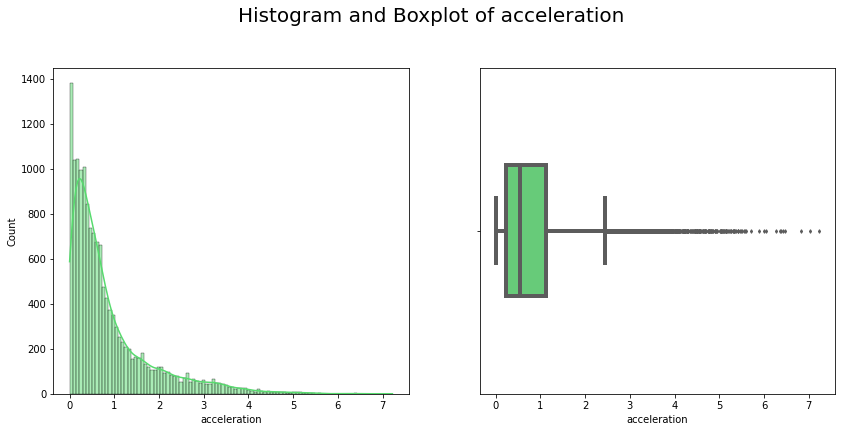

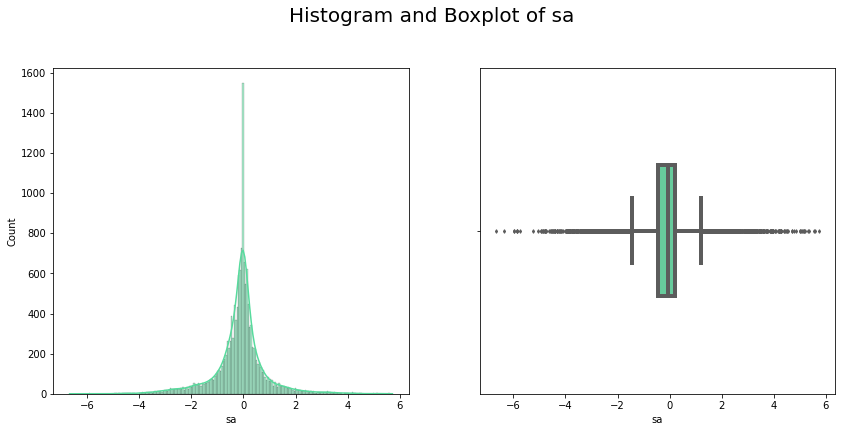

In [30]:
# Histogram and Boxplot
cols = ['x_position', 'y_position', 'speed', 'distance', 'direction', 'orientation', 'acceleration', 'sa']

for idx, col in enumerate(cols):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

    sns.histplot(test_player_df, x=test_player_df[col], kde=True, hue=None,
                 color=sns.color_palette('hls', test_player_df.shape[1])[idx], ax=ax1)
    
    sns.boxplot(x=test_player_df[col], width=.4, linewidth=4, fliersize=2.5,
                color=sns.color_palette('hls', test_player_df.shape[1])[idx], ax=ax2)
    
    fig.suptitle(f'Histogram and Boxplot of {col}', size=20, y=1.02)
    plt.show()

# Sample submission

In [32]:
sb = pd.read_csv('./nfl-player-contact-detection_data/sample_submission.csv')
sb.head()

,contact_id,contact
0,58168_003392_0_38590_43854,0
1,58168_003392_0_38590_41257,0
2,58168_003392_0_38590_41944,0
3,58168_003392_0_38590_42386,0
4,58168_003392_0_38590_47944,0
